#Criando dados Ficticios de Vendas

## instalando o Faker

In [3]:
!pip install faker

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 7.2 MB/s eta 0:00:00


In [4]:
import pandas as pd
from faker import Faker
import random
from random import randint
from datetime import timedelta

# Inicializando o gerador de dados fictícios para o Brasil
fake = Faker('pt_BR')

# Definindo o número de linhas
num_linhas = 30000

# Lista de cidades da região Sudeste do Brasil
cidades_sudeste = ['São Paulo', 'Rio de Janeiro', 'Belo Horizonte', 'Vitória', 'Campinas', 'Santos', 'Niterói', 'Sorocaba', 'Juiz de Fora', 'Uberlândia']

# Lista de produtos
produtos = [
    "Batom Vegan Yara - Terra Cobre",
    "Máscara Vegan Yara - Vento Preto",
    "Base Líquida Vegan Yara - Terra Natural",
    "Corretivo Vegan Yara - Nuvem Clara",
    "Blush Vegan Yara - Fogo Coral",
    "Pó Compacto Vegan Yara - Terra Bronzeada",
    "Delineador Vegan Yara - Vento Preto",
    "Sombra Vegan Yara - Terra Neutra",
    "Batom Líquido Vegan Yara - Fogo Vermelho",
    "Primer Vegan Yara - Vento Matte",
    "BB Cream Vegan Yara - Terra Média",
    "Iluminador Vegan Yara - Fogo Dourado",
    "Contorno Vegan Yara - Terra Suave",
    "Esfoliante Facial Vegan Yara - Água de Chá Verde",
    "Hidratante Facial Vegan Yara - Água de Aloe Vera",
    "Protetor Solar Vegan Yara - Terra FPS 50",
    "Demaquilante Vegan Yara - Água Suave",
    "Sabonete Facial Vegan Yara - Água Profunda",
    "Tônico Facial Vegan Yara - Vento Refrescante",
    "Sérum Facial Vegan Yara - Fogo de Vitamina C",
    "Perfume Vegan Yara - Terra Amadeirada",
    "Perfume Vegan Yara - Vento Fresco",
    "Perfume Vegan Yara - Fogo Picante",
    "Perfume Vegan Yara - Água de Coco",
    "Perfume Vegan Yara - Terra e Mar",
    "Flora Noir Vegan Yara",
    "Floresta Negra Vegan Yara"
]

# Produtos mais vendidos
produtos_mais_vendidos = ["Flora Noir Vegan Yara", "Floresta Negra Vegan Yara"]

# Gerando dados fictícios
dados = {
    "quantidade": [randint(1, 100) for _ in range(num_linhas)],
    "preço": [],
    "custo": [],
    "vendedor": [fake.name() for _ in range(num_linhas)],
    "cliente": [fake.name() for _ in range(num_linhas)],
    "pedido": [],
    "produto": [],
    "filial": [random.choice(cidades_sudeste) for _ in range(num_linhas)],
    "cidade_entrega": [random.choice(cidades_sudeste) for _ in range(num_linhas)],
    "data_venda": [],
    "data_entrega": [],
}

# Gerando números de pedidos únicos
pedidos = list(range(1000, 1000 + num_linhas))
random.shuffle(pedidos)

for _ in range(num_linhas):
    # Garantindo que o custo seja sempre menor que o dobro do preço
    custo = round(random.uniform(5.5, 50.5), 2)
    preço = round(random.uniform(custo, 2 * custo), 2)
    dados["custo"].append(custo)
    dados["preço"].append(preço)

    # Garantindo que a data de entrega seja sempre dentro de 60 dias após a data de venda
    data_venda = fake.date_between(start_date='-1y', end_date='today')
    data_entrega = data_venda + timedelta(days=randint(1, 60))
    dados["data_venda"].append(data_venda)
    dados["data_entrega"].append(data_entrega)

    # Adicionando número de pedido único
    dados["pedido"].append(pedidos[_])

    # Selecionando produto, com maior chance para os produtos mais vendidos
    if random.random() < 0.2:  # 20% de chance de ser um produto mais vendido
        produto = random.choice(produtos_mais_vendidos)
    else:
        produto = random.choice(produtos)
    dados["produto"].append(produto)

# Criando um DataFrame com os dados
df = pd.DataFrame(dados)
df.head()

,quantidade,preço,custo,vendedor,cliente,pedido,produto,filial,cidade_entrega,data_venda,data_entrega
0,23,43.05,32.75,Leonardo Fernandes,Bruno Azevedo,27510,Flora Noir Vegan Yara,Santos,Uberlândia,2023-09-26,2023-10-16
1,3,9.36,6.63,Maria Alice Souza,Marcela Rezende,23611,Sombra Vegan Yara - Terra Neutra,Santos,Vitória,2024-04-29,2024-06-11
2,97,43.77,36.11,Srta. Bella Cardoso,Pedro Miguel Camargo,27981,Floresta Negra Vegan Yara,Vitória,Sorocaba,2023-09-04,2023-10-19
3,58,86.77,47.21,Augusto Sá,Sr. Guilherme Campos,1695,Pó Compacto Vegan Yara - Terra Bronzeada,Juiz de Fora,Vitória,2024-03-01,2024-03-27
4,8,51.37,32.72,João Guilherme Moreira,Stephany Ramos,12271,Batom Líquido Vegan Yara - Fogo Vermelho,Sorocaba,São Paulo,2023-09-08,2023-10-03


#Gerando Excel das Vendas

In [131]:
df.to_excel('dados.xlsx', index=False)

# Importando o modulo files do Colab
from google.colab import files

#Efetuando o download do arquivo
files.download('dados.xlsx')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Importando Dados de Vendas

In [132]:
dfVendas = pd.read_excel('dados.xlsx')
dfVendas.head()

#Limpar a memoria
#del df
#del dados

,quantidade,preço,custo,vendedor,cliente,pedido,produto,filial,cidade_entrega,data_venda,data_entrega
0,23,43.05,32.75,Leonardo Fernandes,Bruno Azevedo,27510,Flora Noir Vegan Yara,Santos,Uberlândia,2023-09-26,2023-10-16
1,3,9.36,6.63,Maria Alice Souza,Marcela Rezende,23611,Sombra Vegan Yara - Terra Neutra,Santos,Vitória,2024-04-29,2024-06-11
2,97,43.77,36.11,Srta. Bella Cardoso,Pedro Miguel Camargo,27981,Floresta Negra Vegan Yara,Vitória,Sorocaba,2023-09-04,2023-10-19
3,58,86.77,47.21,Augusto Sá,Sr. Guilherme Campos,1695,Pó Compacto Vegan Yara - Terra Bronzeada,Juiz de Fora,Vitória,2024-03-01,2024-03-27
4,8,51.37,32.72,João Guilherme Moreira,Stephany Ramos,12271,Batom Líquido Vegan Yara - Fogo Vermelho,Sorocaba,São Paulo,2023-09-08,2023-10-03


In [134]:
dfVendas.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 11 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   quantidade      30000 non-null  int64         
 1   preço           30000 non-null  float64       
 2   custo           30000 non-null  float64       
 3   vendedor        30000 non-null  object        
 4   cliente         30000 non-null  object        
 5   pedido          30000 non-null  int64         
 6   produto         30000 non-null  object        
 7   filial          30000 non-null  object        
 8   cidade_entrega  30000 non-null  object        
 9   data_venda      30000 non-null  datetime64[ns]
 10  data_entrega    30000 non-null  datetime64[ns]
dtypes: datetime64[ns](2), float64(2), int64(2), object(5)
memory usage: 2.5+ MB


In [135]:
dfVendas.describe()

,quantidade,preço,custo,pedido,data_venda,data_entrega
count,30000.000000,30000.000000,30000.000000,30000.000000,30000,30000
mean,50.506500,42.026857,28.011237,15999.500000,2023-12-11 12:09:21.600000,2024-01-10 20:08:47.040000256
min,1.000000,5.550000,5.500000,1000.000000,2023-06-12 00:00:00,2023-06-13 00:00:00
25%,26.000000,24.190000,16.717500,8499.750000,2023-09-11 00:00:00,2023-10-11 00:00:00
50%,51.000000,40.490000,27.990000,15999.500000,2023-12-11 00:00:00,2024-01-11 00:00:00
75%,75.000000,57.230000,39.310000,23499.250000,2024-03-13 00:00:00,2024-04-12 00:00:00
max,100.000000,100.410000,50.500000,30999.000000,2024-06-11 00:00:00,2024-08-09 00:00:00
std,28.883554,21.435764,13.013508,8660.398374,NaN,NaN


In [136]:
dfVendas.dtypes

quantidade                 int64
preço                    float64
custo                    float64
vendedor                  object
cliente                   object
pedido                     int64
produto                   object
filial                    object
cidade_entrega            object
data_venda        datetime64[ns]
data_entrega      datetime64[ns]
dtype: object

#Calculando novas colunas

In [137]:
#from google.colab import drive
#drive.mount('/content/drive')

##Custo total do pedido

In [138]:
dfVendas['Custo Total'] = dfVendas['custo'] * dfVendas['quantidade']
dfVendas['Custo Total'].head()

0     753.25
1      19.89
2    3502.67
3    2738.18
4     261.76
Name: Custo Total, dtype: float64

##Valor de Venda do Pedido

In [139]:
dfVendas['Valor de Venda'] = dfVendas['preço'] * dfVendas['quantidade']
dfVendas['Valor de Venda'].head()

0     990.15
1      28.08
2    4245.69
3    5032.66
4     410.96
Name: Valor de Venda, dtype: float64

##Lucro do Pedido

In [140]:
dfVendas['Lucro'] = dfVendas['Valor de Venda'] - dfVendas['Custo Total']
dfVendas['Lucro'].head()

0     236.90
1       8.19
2     743.02
3    2294.48
4     149.20
Name: Lucro, dtype: float64

#Agrupando Dados

In [141]:
print('\nVendas Por Vendedor')
VendasPorVendedor = dfVendas.groupby('vendedor')['Valor de Venda'].sum()
VendasPorVendedor


Vendas Por Vendedor


vendedor
Agatha Abreu         1101.93
Agatha Almeida        931.50
Agatha Alves         3506.34
Agatha Aparecida     1087.56
Agatha Aragão        2864.04
                      ...   
Ísis da Mota        12337.19
Ísis da Paz           878.50
Ísis da Rocha        4322.78
Ísis da Rosa         3133.36
Ísis das Neves       1496.24
Name: Valor de Venda, Length: 21487, dtype: float64

In [142]:
print('\nLucro Por Vendedor')
LucroPorVendedor = dfVendas.groupby('vendedor')['Lucro'].sum()
LucroPorVendedor


Lucro Por Vendedor


vendedor
Agatha Abreu         523.48
Agatha Almeida       184.00
Agatha Alves        1386.14
Agatha Aparecida     313.20
Agatha Aragão        803.88
                     ...   
Ísis da Mota        2944.87
Ísis da Paz          232.40
Ísis da Rocha        733.81
Ísis da Rosa        1342.64
Ísis das Neves       600.26
Name: Lucro, Length: 21487, dtype: float64

#Formatando Dados

In [143]:
# Definindo a formatação da moeda
moeda_brasileira = "R$ {:,.2f}"

In [144]:
VendasPorVendedor = VendasPorVendedor.apply(lambda x: moeda_brasileira.format(x))
VendasPorVendedor

vendedor
Agatha Abreu         R$ 1,101.93
Agatha Almeida         R$ 931.50
Agatha Alves         R$ 3,506.34
Agatha Aparecida     R$ 1,087.56
Agatha Aragão        R$ 2,864.04
                        ...     
Ísis da Mota        R$ 12,337.19
Ísis da Paz            R$ 878.50
Ísis da Rocha        R$ 4,322.78
Ísis da Rosa         R$ 3,133.36
Ísis das Neves       R$ 1,496.24
Name: Valor de Venda, Length: 21487, dtype: object

#Gerando Gráficos

In [145]:
# Importando biblioteca de gráficos
import matplotlib.pyplot as plt

## Importando a logo da empresa

In [146]:
# prompt: como inserir a imagem https://github.com/Grupo4Entrega1/projetoIntegrador1/blob/main/Old/logo.jpg

import requests
from google.colab import files

url = 'https://github.com/Grupo4Entrega1/projetoIntegrador1/blob/main/Old/logo.jpg?raw=true'
response = requests.get(url)

with open('logo.jpg', 'wb') as f:
  f.write(response.content)




In [147]:
# Primeiro, certifique-se de que 'data_venda' é do tipo datetime
dfVendas['data_venda'] = pd.to_datetime(dfVendas['data_venda'])

# Crie uma nova coluna 'mes' que representa o mês de cada venda
dfVendas['mes'] = dfVendas['data_venda'].dt.month

# Agora, agrupe por 'mes' e some 'Valor de Venda'
VendasPorMes = dfVendas.groupby('mes')['Valor de Venda'].sum()
VendasPorMes



mes
1     5211388.16
2     4862109.00
3     5483860.09
4     5255764.40
5     5420462.74
6     5322248.86
7     5543862.91
8     5320247.12
9     4994627.75
10    5641196.41
11    5245049.83
12    5490158.31
Name: Valor de Venda, dtype: float64

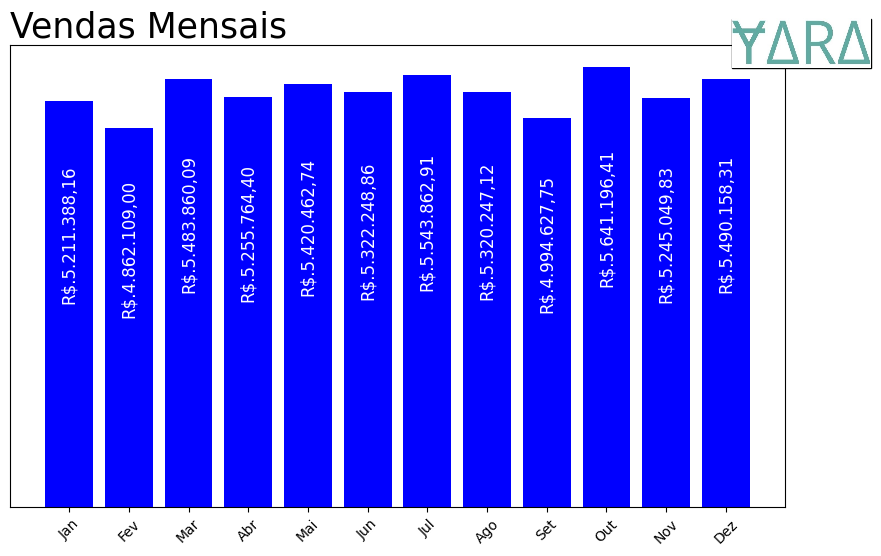

In [148]:
import matplotlib.image as mpimg
from matplotlib.offsetbox import OffsetImage, AnnotationBbox

# Dados de exemplo
meses = ['Jan', 'Fev', 'Mar', 'Abr', 'Mai', 'Jun', 'Jul', 'Ago', 'Set', 'Out', 'Nov', 'Dez']
plt.figure(figsize=(10,6))
barras = plt.bar(meses, VendasPorMes, color='blue')


# Adiciona a logo
logo = mpimg.imread('logo.jpg') # Substitua 'caminho_para_sua_logo.png' pelo caminho real para o arquivo da sua logo
imagebox = OffsetImage(logo, zoom=0.2) # Ajuste o valor de 'zoom' para alterar o tamanho da logo
ab = AnnotationBbox(imagebox, (1.02, 1), xycoords='axes fraction', boxcoords="offset points", pad=0)
plt.gca().add_artist(ab)

# Adiciona rótulos às barras
for barra in barras:
    yval = barra.get_height()
    plt.text(barra.get_x() + barra.get_width()/2, yval/2, moeda_brasileira.format(yval).replace(',', ' ').replace('.', ',').replace(' ', '.'), ha='center', va='bottom', rotation=90, color='white', size=12)

plt.title('Vendas Mensais', loc='left',size=25) # Posiciona o título à esquerda
# removendo a poluição visual
plt.xlabel('') # Remove a legenda do rótulo pois o Proprio Rotulo é objetivo se referenciando a Mês
plt.ylabel('') # Remove a legenda da escala pois o Proprio Valor já esta formatado como R$ e o titulo se refere a venda
plt.yticks([]) # Remove a escala de valores
plt.xticks(rotation=45) # Rotaciona os rótulos dos meses

plt.show()


# Filtrando Dados

In [149]:
produtoFiltro = dfVendas[dfVendas['produto'] == 'Flora Noir Vegan Yara']
produtoFiltro.head()

,quantidade,preço,custo,vendedor,cliente,pedido,produto,filial,cidade_entrega,data_venda,data_entrega,Custo Total,Valor de Venda,Lucro,mes
0,23,43.05,32.75,Leonardo Fernandes,Bruno Azevedo,27510,Flora Noir Vegan Yara,Santos,Uberlândia,2023-09-26,2023-10-16,753.25,990.15,236.90,9
5,8,22.14,11.80,Isadora Rios,Júlia Fogaça,23880,Flora Noir Vegan Yara,Sorocaba,Vitória,2024-01-26,2024-03-12,94.40,177.12,82.72,1
13,53,55.39,33.10,Anthony Rios,Dr. Enrico Guerra,27194,Flora Noir Vegan Yara,Uberlândia,Sorocaba,2023-11-25,2023-11-27,1754.30,2935.67,1181.37,11
18,43,49.97,38.16,Manuella Fonseca,Sra. Gabriela Rios,14547,Flora Noir Vegan Yara,Vitória,Santos,2023-11-20,2023-12-23,1640.88,2148.71,507.83,11
30,68,9.42,5.61,Antony Sousa,Matheus Pinto,25759,Flora Noir Vegan Yara,Rio de Janeiro,Santos,2023-10-03,2023-11-07,381.48,640.56,259.08,10


In [150]:
# Filtre os dados para analisar apenas as vendas de um determinado produto
produtoFiltro = input('Informe o produto que deseja consultar: ')
vendas_filtradas = dfVendas[(dfVendas['produto'] == produtoFiltro)]
vendas_filtradas.head()

Informe o produto que deseja consultar: Flora Noir Vegan Yara


,quantidade,preço,custo,vendedor,cliente,pedido,produto,filial,cidade_entrega,data_venda,data_entrega,Custo Total,Valor de Venda,Lucro,mes
0,23,43.05,32.75,Leonardo Fernandes,Bruno Azevedo,27510,Flora Noir Vegan Yara,Santos,Uberlândia,2023-09-26,2023-10-16,753.25,990.15,236.90,9
5,8,22.14,11.80,Isadora Rios,Júlia Fogaça,23880,Flora Noir Vegan Yara,Sorocaba,Vitória,2024-01-26,2024-03-12,94.40,177.12,82.72,1
13,53,55.39,33.10,Anthony Rios,Dr. Enrico Guerra,27194,Flora Noir Vegan Yara,Uberlândia,Sorocaba,2023-11-25,2023-11-27,1754.30,2935.67,1181.37,11
18,43,49.97,38.16,Manuella Fonseca,Sra. Gabriela Rios,14547,Flora Noir Vegan Yara,Vitória,Santos,2023-11-20,2023-12-23,1640.88,2148.71,507.83,11
30,68,9.42,5.61,Antony Sousa,Matheus Pinto,25759,Flora Noir Vegan Yara,Rio de Janeiro,Santos,2023-10-03,2023-11-07,381.48,640.56,259.08,10


In [151]:
# Filtre parte da string do Produto
produtoFiltroParte = input('Informe o produto ou parte do texto que deseja consultar: ').upper() # lower()
dfVendas['ProdutoUpper'] = dfVendas['produto'].str.upper()
vendas_filtradasParte = dfVendas[(dfVendas['ProdutoUpper'].str.contains(produtoFiltroParte))]
vendas_filtradasParte.head()

Informe o produto ou parte do texto que deseja consultar: perfume


,quantidade,preço,custo,vendedor,cliente,pedido,produto,filial,cidade_entrega,data_venda,data_entrega,Custo Total,Valor de Venda,Lucro,mes,ProdutoUpper
20,72,56.12,39.08,Ian Viana,Julia Nogueira,25043,Perfume Vegan Yara - Água de Coco,São Paulo,Uberlândia,2024-01-09,2024-02-13,2813.76,4040.64,1226.88,1,PERFUME VEGAN YARA - ÁGUA DE COCO
25,40,66.98,38.02,Sra. Emilly Camargo,Melina Mendes,15430,Perfume Vegan Yara - Terra Amadeirada,Santos,Uberlândia,2023-07-02,2023-08-11,1520.80,2679.20,1158.40,7,PERFUME VEGAN YARA - TERRA AMADEIRADA
27,70,38.40,34.47,Noah Vasconcelos,Maria Julia Viana,23096,Perfume Vegan Yara - Água de Coco,Belo Horizonte,Juiz de Fora,2023-12-19,2024-02-11,2412.90,2688.00,275.10,12,PERFUME VEGAN YARA - ÁGUA DE COCO
29,51,14.12,9.98,Pietro Ribeiro,Dr. Theodoro Fonseca,4347,Perfume Vegan Yara - Água de Coco,Campinas,Campinas,2023-11-17,2024-01-01,508.98,720.12,211.14,11,PERFUME VEGAN YARA - ÁGUA DE COCO
32,95,55.98,34.38,Dra. Liz Pacheco,Benício Fogaça,11975,Perfume Vegan Yara - Terra e Mar,Santos,Sorocaba,2023-12-16,2023-12-23,3266.10,5318.10,2052.00,12,PERFUME VEGAN YARA - TERRA E MAR


# Produtos mais vendidos

In [152]:
produto_mais_vendido = dfVendas.groupby('produto')['quantidade'].sum().idxmax()
print(f'Produto mais vendido em quantidade é: {produto_mais_vendido}')

Produto mais vendido em quantidade é: Flora Noir Vegan Yara


In [153]:
produtos_selecionados = ['Flora Noir Vegan Yara', 'Floresta Negra Vegan Yara']

df_filtrado = dfVendas[dfVendas['produto'].isin(produtos_selecionados)]
df_filtrado.head()


,quantidade,preço,custo,vendedor,cliente,pedido,produto,filial,cidade_entrega,data_venda,data_entrega,Custo Total,Valor de Venda,Lucro,mes,ProdutoUpper
0,23,43.05,32.75,Leonardo Fernandes,Bruno Azevedo,27510,Flora Noir Vegan Yara,Santos,Uberlândia,2023-09-26,2023-10-16,753.25,990.15,236.90,9,FLORA NOIR VEGAN YARA
2,97,43.77,36.11,Srta. Bella Cardoso,Pedro Miguel Camargo,27981,Floresta Negra Vegan Yara,Vitória,Sorocaba,2023-09-04,2023-10-19,3502.67,4245.69,743.02,9,FLORESTA NEGRA VEGAN YARA
5,8,22.14,11.80,Isadora Rios,Júlia Fogaça,23880,Flora Noir Vegan Yara,Sorocaba,Vitória,2024-01-26,2024-03-12,94.40,177.12,82.72,1,FLORA NOIR VEGAN YARA
6,79,18.33,12.92,Diogo Albuquerque,Marcela Pereira,12696,Floresta Negra Vegan Yara,Uberlândia,Rio de Janeiro,2024-02-19,2024-04-04,1020.68,1448.07,427.39,2,FLORESTA NEGRA VEGAN YARA
8,27,69.03,49.71,Vitória Mendes,Esther Silveira,12920,Floresta Negra Vegan Yara,Santos,Vitória,2023-09-05,2023-09-30,1342.17,1863.81,521.64,9,FLORESTA NEGRA VEGAN YARA


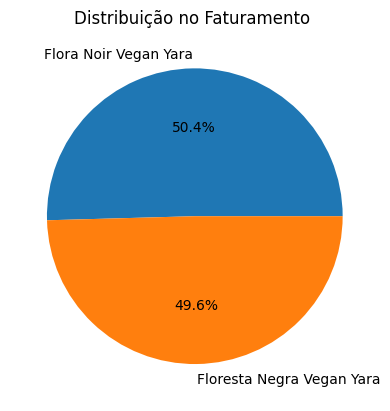

In [154]:
df_filtrado.groupby('produto')['Valor de Venda'].sum().plot.pie(title='Distribuição no Faturamento ', autopct='%1.1f%%', subplots=False, ylabel='',legend=False)

plt.show()

# GeoReferenciamento

In [178]:
# Dicionário de cidades para códigos IBGE (exemplo)
cidade_codigo_ibge = {
    'São Paulo': '3550308',
    'Rio de Janeiro': '3304557',
    'Belo Horizonte': '3106200',
    'Vitória': '3205309',
    'Campinas': '3509502',
    'Santos': '3548500',
    'Niterói': '3303302',
    'Sorocaba': '3552205',
    'Juiz de Fora': '3136702',
    'Uberlândia': '3170206'
}

In [179]:
# Adicionando a coluna do código IBGE
dfVendas['codigo_ibge'] = dfVendas['cidade_entrega'].map(cidade_codigo_ibge)

dfVendas.head()

,quantidade,preço,custo,vendedor,cliente,pedido,produto,filial,cidade_entrega,data_venda,data_entrega,Custo Total,Valor de Venda,Lucro,mes,ProdutoUpper,Rótulo,codigo_ibge
0,23,43.05,32.75,Leonardo Fernandes,Bruno Azevedo,27510,Flora Noir Vegan Yara,Santos,Uberlândia,2023-09-26,2023-10-16,753.25,990.15,236.90,9,FLORA NOIR VEGAN YARA,"Uberlândia: R$ 6,617,652.08",3170206
1,3,9.36,6.63,Maria Alice Souza,Marcela Rezende,23611,Sombra Vegan Yara - Terra Neutra,Santos,Vitória,2024-04-29,2024-06-11,19.89,28.08,8.19,4,SOMBRA VEGAN YARA - TERRA NEUTRA,"Vitória: R$ 6,687,840.08",3205309
2,97,43.77,36.11,Srta. Bella Cardoso,Pedro Miguel Camargo,27981,Floresta Negra Vegan Yara,Vitória,Sorocaba,2023-09-04,2023-10-19,3502.67,4245.69,743.02,9,FLORESTA NEGRA VEGAN YARA,"Sorocaba: R$ 6,349,527.26",3552205
3,58,86.77,47.21,Augusto Sá,Sr. Guilherme Campos,1695,Pó Compacto Vegan Yara - Terra Bronzeada,Juiz de Fora,Vitória,2024-03-01,2024-03-27,2738.18,5032.66,2294.48,3,PÓ COMPACTO VEGAN YARA - TERRA BRONZEADA,"Vitória: R$ 6,687,840.08",3205309
4,8,51.37,32.72,João Guilherme Moreira,Stephany Ramos,12271,Batom Líquido Vegan Yara - Fogo Vermelho,Sorocaba,São Paulo,2023-09-08,2023-10-03,261.76,410.96,149.20,9,BATOM LÍQUIDO VEGAN YARA - FOGO VERMELHO,"São Paulo: R$ 6,027,481.76",3550308


In [180]:
# Fazendo download do conjunto de dados
!wget --verbose --show-progress --no-check-certificate https://raw.githubusercontent.com/jonates/opendata/master/arquivos_geoespaciais/geojs-100-mun.json

--2024-06-12 02:00:06--  https://raw.githubusercontent.com/jonates/opendata/master/arquivos_geoespaciais/geojs-100-mun.json
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.111.133, 185.199.110.133, 185.199.108.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.111.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 22549321 (22M) [text/plain]
Saving to: ‘geojs-100-mun.json.1’

geojs-100-mun.json. 100%[===================>]  21.50M   116MB/s    in 0.2s    

2024-06-12 02:00:06 (116 MB/s) - ‘geojs-100-mun.json.1’ saved [22549321/22549321]



In [181]:
# Importando biblioteca necessária
import json

# Abrindo o JSON e guardando em um objeto Python
objeto_geo_cidades = open('/content/geojs-100-mun.json',)

# Lendo o arquivo georreferenciado no formato JSON
geo_uf = json.load(objeto_geo_cidades)

In [182]:
# Renomeando o ibgeID para id igual ao do arquivo geoespacial
dfVendas = dfVendas.rename(columns={'codigo_ibge':'id'})

# transformando o 'id' para tipo object, o mesmo do geoespacial
dfVendas['id'] = dfVendas['id'].astype('str')

In [183]:
# Importando biblioteca necessaria
import plotly.express as px

In [192]:
# Primeiro, vamos calcular a soma do 'Valor de Venda' para cada localização
dfVendas['Soma_Vendas'] = dfVendas.groupby('id')['Valor de Venda'].transform('sum')
dfVendas['Rótulo'] = dfVendas['cidade_entrega'] + ': ' + dfVendas['Soma_Vendas'].apply(lambda x: moeda_brasileira.format(x)).astype(str)

# plotando o mapa
mapa_vendas_cidades = px.choropleth_mapbox(
    data_frame = dfVendas,
    geojson = geo_uf,
    locations='id',
    featureidkey='properties.id',
    color_continuous_scale= 'reds',
    range_color=(150, 450),
    mapbox_style='open-street-map',
    zoom=5.5,
    center = {"lat": -23.5475, "lon": -46.6361},
    opacity=1,
    hover_name='Rótulo',
    width = 1000,
    height = 800,
    title = 'Vendas'
)
mapa_vendas_cidades.update_layout(margin={'r':0,'t':0,'l':0, 'b':0})
mapa_vendas_cidades.update_traces(marker_line_width=0.01)
mapa_vendas_cidades.show()